## Este notebook es en el que trabajaremos a partir del dataset generado con los barrios y municipios.
En el anterior notebook realizamos la gran parte del análisis exploratorio de datos.

En este notebook realizaremos un análisis a partir del csv generado incluyendo los barrios y municipio de los pisos anunciados a la venta en idealista.

Por otro lado, también realizaremos el modelado para predecir precios futuros.

In [1]:
# Importamos las librerías
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder
from utils.milibreria import * 
import re
import plotly.express as px
# mapas interactivos
import folium
from folium.plugins import FastMarkerCluster
import geopandas as gpd
from branca.colormap import LinearColormap

In [2]:
# Cargamos el dataset.
valencia = pd.read_csv("data/valencia_barrio_municipio.csv")
valencia.drop('Unnamed: 0', axis =1, inplace=True)
valencia.drop('ID', axis =1, inplace=True)
valencia.drop('Municipio', axis=1, inplace=True)

# Mostramos el dataframe
valencia

,Precio,Preciom2,Metros_Construidos,Habitaciones,Baños,Terraza,Ascensor,Aire_Acondicionado,Servicios,Garaje,...,Año_diseñado,Plantas_máximas,Número_viviendas,Calidad_catastral,Distancia_centro,Distancia_metro,Distancia_Blasco,Latitud,Longitud,Barrio
0,111000.0,1480.00,75,2,1,1,1,1,2,1,...,2001,7,35,6,3.759093,0.756517,3.373132,39.500908,-0.393538,CIUTAT FALLERA
1,169000.0,1320.31,128,4,2,0,1,1,3,1,...,1976,7,56,5,2.073773,0.370680,0.540594,39.482599,-0.359125,BENIMACLET
2,162000.0,1883.72,86,2,1,0,1,1,3,0,...,2010,6,20,4,2.099641,0.038560,0.719203,39.485144,-0.362470,BENIMACLET
3,199000.0,1792.79,111,4,2,0,1,0,3,0,...,1977,8,25,5,2.120917,0.524827,0.915379,39.487445,-0.367417,BENIMACLET
4,73000.0,1303.57,56,3,1,1,1,0,3,0,...,1960,6,20,8,3.087950,1.129985,2.009535,39.497057,-0.370182,ELS ORRIOLS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33617,121000.0,1008.33,120,3,2,0,1,1,3,0,...,1982,4,13,5,2.800362,0.710564,2.607601,39.492210,-0.391340,BENICALAP
33618,136000.0,1619.05,84,2,1,1,1,1,3,0,...,1970,6,49,7,2.282765,0.321158,2.404973,39.486174,-0.392554,EL CALVARI
33619,98000.0,867.26,113,2,2,1,0,0,3,0,...,1974,6,17,7,2.583955,0.661318,2.510628,39.489754,-0.391909,BENICALAP
33620,45000.0,661.76,68,3,1,0,0,0,3,0,...,1963,6,41,7,3.420772,0.529830,3.305286,39.495606,-0.398167,BENICALAP


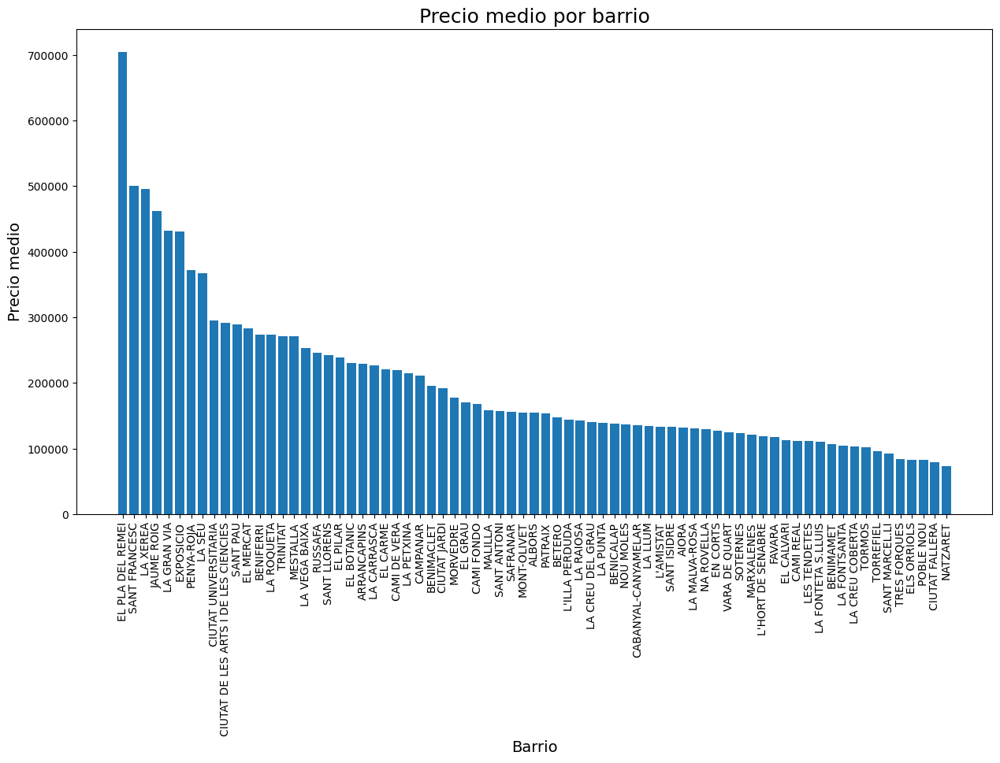

In [3]:
# Agrupar los datos por barrio y calcular la media del precio
precio_medio = valencia.groupby('Barrio')['Precio'].mean()

# Ordenar los datos de manera descendente
precio_medio = precio_medio.sort_values(ascending=False)

# Graficar los datos
fig, ax = plt.subplots(figsize=(15,8))
ax.bar(precio_medio.index, precio_medio.values)
ax.set_title('Precio medio por barrio', fontsize=18)
ax.set_xlabel('Barrio', fontsize=14)
ax.set_ylabel('Precio medio', fontsize=14)
ax.tick_params(axis='x', labelrotation=90)
plt.show()


In [4]:
top_3 = valencia.groupby('Barrio')['Precio'].sum().sort_values(ascending=False)[:3]
top_3_names = list(top_3.index)

top_3_counts = valencia['Barrio'].value_counts()[top_3_names]

print("Los barrios que más ingresos supondrían son:")
for i in range(len(top_3_names)):
    print(f"{top_3_names[i]} con unos posibles ingresos respectivos de {int(top_3[i])} € teniendo {top_3_counts[i]} anuncios publicados.")


Los barrios que más ingresos supondrían son:
SANT FRANCESC con unos posibles ingresos respectivos de 446856000 € teniendo 893 anuncios publicados.
EL PLA DEL REMEI con unos posibles ingresos respectivos de 425405000 € teniendo 604 anuncios publicados.
RUSSAFA con unos posibles ingresos respectivos de 319293000 € teniendo 1298 anuncios publicados.


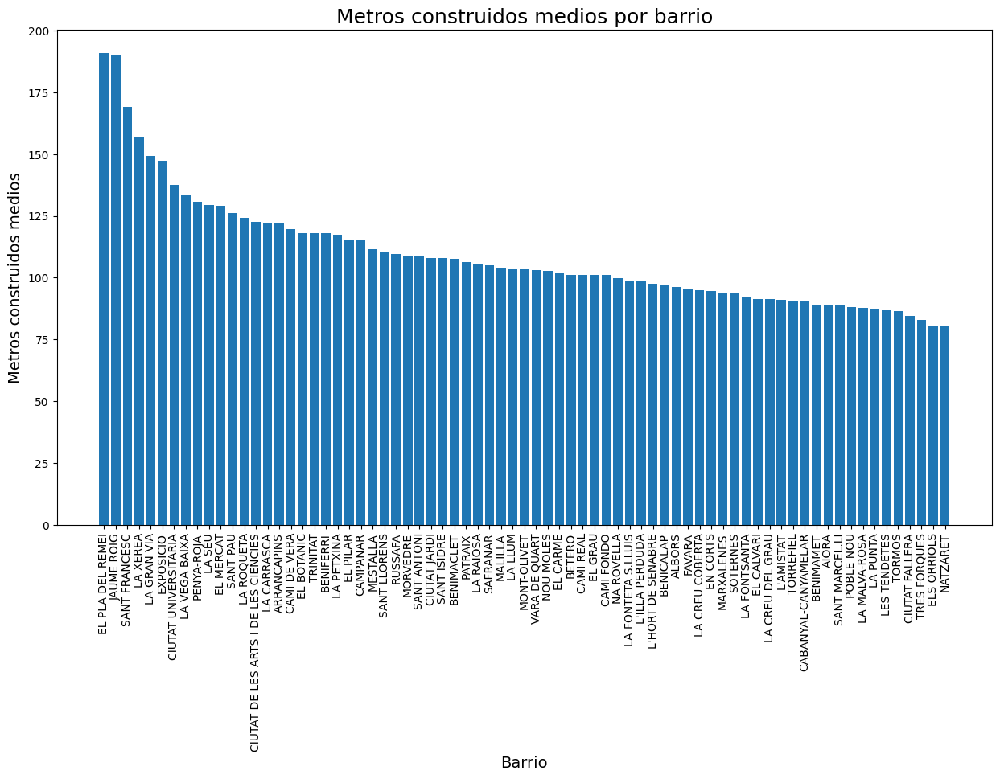

In [5]:
metros_medios = valencia.groupby('Barrio')['Metros_Construidos'].mean()

metros_medios = metros_medios.sort_values(ascending=False)

fig, ax = plt.subplots(figsize=(15,8))
ax.bar(metros_medios.index, metros_medios.values)
ax.set_title('Metros construidos medios por barrio', fontsize=18)
ax.set_xlabel('Barrio', fontsize=14)
ax.set_ylabel('Metros construidos medios', fontsize=14)
ax.tick_params(axis='x', labelrotation=90)
plt.show()


In [6]:
# Obtener los datos de los top 3 y los últimos 3 barrios
top_3_barrios = list(valencia.groupby('Barrio')['Precio'].sum().sort_values(ascending=False)[:3].index)
ultimos_3_barrios = list(valencia.groupby('Barrio')['Precio'].sum().sort_values(ascending=True)[:3].index)

# Filtrar el DataFrame para incluir solo los datos de los top 3 y últimos 3 barrios
valencia_top_3_ultimos_3 = valencia[valencia['Barrio'].isin(top_3_barrios + ultimos_3_barrios)]

# Calcular la media de los metros construidos para los top 3 y los últimos 3 barrios
metros_construidos_top_3 = valencia_top_3_ultimos_3[valencia_top_3_ultimos_3['Barrio'].isin(top_3_barrios)].groupby('Barrio')['Metros_Construidos'].mean()
metros_construidos_ultimos_3 = valencia_top_3_ultimos_3[valencia_top_3_ultimos_3['Barrio'].isin(ultimos_3_barrios)].groupby('Barrio')['Metros_Construidos'].mean()

# Imprimir los resultados
print("Metros construidos medios para los top 3 barrios:")
for barrio, metros in metros_construidos_top_3.items():
    print(f"{barrio}: {round(metros, 2)} metros cuadrados")

print("\nMetros construidos medios para los últimos 3 barrios:")
for barrio, metros in metros_construidos_ultimos_3.items():
    print(f"{barrio}: {round(metros, 2)} metros cuadrados")


Metros construidos medios para los top 3 barrios:
EL PLA DEL REMEI: 190.8 metros cuadrados
RUSSAFA: 109.61 metros cuadrados
SANT FRANCESC: 169.0 metros cuadrados

Metros construidos medios para los últimos 3 barrios:
BENIFERRI: 117.92 metros cuadrados
BENIMAMET: 89.0 metros cuadrados
POBLE NOU: 88.08 metros cuadrados


In [6]:
# Filtrar los datos para incluir solo los valores posteriores a 1899
valencia_filtered = valencia[valencia['Año_construcción'] > 1899]

# Crear el gráfico de dispersión
fig = px.scatter(valencia_filtered, x='Año_construcción', y='Metros_Construidos', color='Barrio', hover_name='Barrio', 
                 title='Relación entre año de construcción y superficie de viviendas en Valencia')

fig.show()


In [7]:
# Crear un dataframe con los datos de interés
df = valencia[valencia['Año_construcción'] > 1899].groupby(['Año_construcción', 'Barrio'])['Metros_Construidos'].max().reset_index()

# Filtrar solo los máximos de metros construidos por cada año
df = df.groupby('Año_construcción').agg({'Metros_Construidos': 'max', 'Barrio': 'first'}).reset_index()

# Crear la gráfica lineal con Plotly Express
fig = px.line(df, x='Año_construcción', y='Metros_Construidos', hover_name='Barrio')
fig.update_layout(title='Máximo de metros construidos por año', xaxis_title='Año de construcción', yaxis_title='Metros construidos')
fig.show()


In [10]:
# Calcular el año de construcción medio para los 3 barrios con mayor suma de precios
top_3_año = valencia[valencia['Barrio'].isin(top_3_names)].groupby('Barrio')['Año_construcción'].mean()
print("El año de construcción medio para los 3 barrios con mayor suma de precios son:")
for i in range(len(top_3_names)):
    print(f"{top_3_names[i]} con un año de construcción medio de {int(top_3_año[top_3_names[i]])}.")

# Calcular el año de construcción medio para los 3 barrios con menor suma de precios
last_3_names = list(precio_medio.tail(3).index)
last_3_año = valencia[valencia['Barrio'].isin(last_3_names)].groupby('Barrio')['Año_construcción'].mean()
print("-------------------")
print("El año de construcción medio para los 3 barrios con menor precio medio son:")
for i in range(len(last_3_names)):
    print(f"{last_3_names[i]} con un año de construcción medio de {int(last_3_año[last_3_names[i]])}.")


El año de construcción medio para los 3 barrios con mayor suma de precios son:
SANT FRANCESC con un año de construcción medio de 1962.
EL PLA DEL REMEI con un año de construcción medio de 1956.
RUSSAFA con un año de construcción medio de 1958.
-------------------
El año de construcción medio para los 3 barrios con menor precio medio son:
POBLE NOU con un año de construcción medio de 1968.
CIUTAT FALLERA con un año de construcción medio de 1969.
NATZARET con un año de construcción medio de 1968.


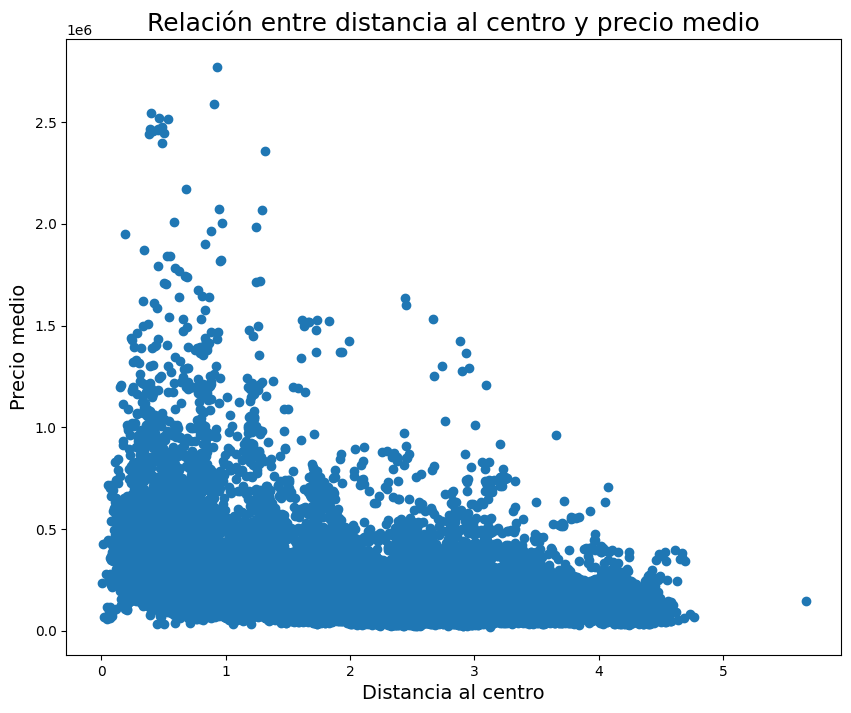

In [11]:
# Calcular el precio medio por distancia al centro
precio_medio = valencia.groupby('Distancia_centro')['Precio'].mean()

# Graficar los datos
fig, ax = plt.subplots(figsize=(10,8))
ax.scatter(precio_medio.index, precio_medio.values)
ax.set_title('Relación entre distancia al centro y precio medio', fontsize=18)
ax.set_xlabel('Distancia al centro', fontsize=14)
ax.set_ylabel('Precio medio', fontsize=14)
plt.show()


In [39]:
precio_medio_piscina = valencia[valencia['Piscina'] == 1]['Precio'].mean()
precio_medio_no_piscina = valencia[valencia['Piscina'] == 0]['Precio'].mean()
print("El precio medio de los inmuebles que tienen piscina en valencia es de {} €".format(int(precio_medio_piscina)))
print("En cambio, el precio medio de los inmuebles que no tienen piscina es de {} €".format(int(precio_medio_no_piscina)))

print("----------------------------")
precio_medio_conserje = valencia[valencia['Conserje'] == 1]['Precio'].mean()
print("El precio medio de los inmuebles que tienen conserje en valencia es de {} €".format(int(precio_medio_conserje)))
precio_medio_no_conserje = valencia[valencia['Conserje'] == 0]['Precio'].mean()
print("En cambio, el precio medio de los inmuebles que no tienen conserje en valencia es de {} €".format(int(precio_medio_no_conserje)))

print("----------------------------")
precio_medio_jardin = valencia[valencia['Jardín'] == 1]['Precio'].mean()
print("El precio medio de los inmuebles que tienen jardín en valencia es de {} €".format(int(precio_medio_jardin)))
precio_medio_no_jardin = valencia[valencia['Jardín'] == 0]['Precio'].mean()
print("En cambio, el precio medio de los inmuebles que no tienen jardín en valencia es de {} €".format(int(precio_medio_no_jardin)))

print("----------------------------")
precio_medio_duplex = valencia[valencia['Duplex'] == 1]['Precio'].mean()
print("El precio medio de los inmuebles que son dúplex en valencia es de {} €".format(int(precio_medio_duplex)))
precio_medio_no_duplex = valencia[valencia['Duplex'] == 0]['Precio'].mean()
print("En cambio, el precio medio de los inmuebles que no son dúplex en valencia es de {} €".format(int(precio_medio_no_duplex)))

print("----------------------------")
precio_medio_estudio = valencia[valencia['Estudio'] == 1]['Precio'].mean()
print("El precio medio de los inmuebles que son estudios en valencia es de {} €".format(int(precio_medio_estudio)))
precio_medio_no_estudio = valencia[valencia['Estudio'] == 0]['Precio'].mean()
print("En cambio, el precio medio de los inmuebles que no son estudios en valencia es de {} €".format(int(precio_medio_no_estudio)))

print("----------------------------")
precio_medio_aticos = valencia[valencia['Ático'] == 1]['Precio'].mean()
print("El precio medio de los inmuebles que son áticos en valencia es de {} €".format(int(precio_medio_aticos)))
precio_medio_no_atico = valencia[valencia['Ático'] == 0]['Precio'].mean()
print("En cambio, el precio medio de los inmuebles que no son áticos en valencia es de {} €".format(int(precio_medio_no_atico)))

print("----------------------------")


El precio medio de los inmuebles que tienen piscina en valencia es de 289326 €
En cambio, el precio medio de los inmuebles que no tienen piscina es de 192765 €
----------------------------
El precio medio de los inmuebles que tienen conserje en valencia es de 406426 €
En cambio, el precio medio de los inmuebles que no tienen conserje en valencia es de 188257 €
----------------------------
El precio medio de los inmuebles que tienen jardín en valencia es de 283987 €
En cambio, el precio medio de los inmuebles que no tienen jardín en valencia es de 194243 €
----------------------------
El precio medio de los inmuebles que son dúplex en valencia es de 314194 €
En cambio, el precio medio de los inmuebles que no son dúplex en valencia es de 197537 €
----------------------------
El precio medio de los inmuebles que son estudios en valencia es de 154187 €
En cambio, el precio medio de los inmuebles que no son estudios en valencia es de 199961 €
----------------------------
El precio medio de 

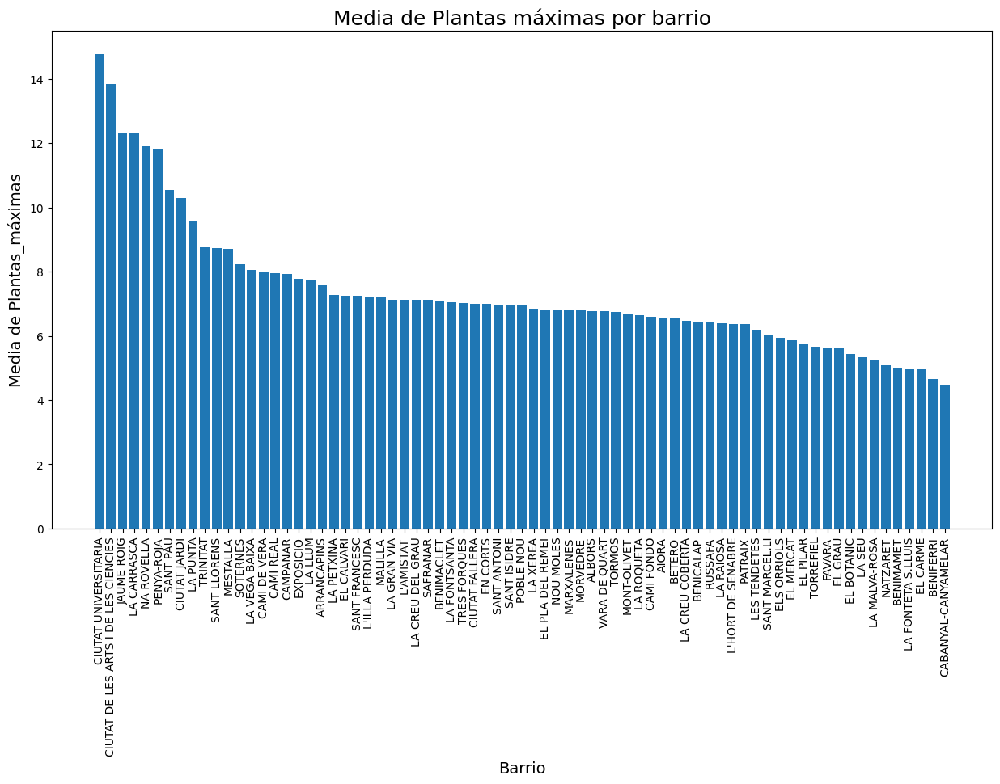

In [41]:
import matplotlib.pyplot as plt

# Obtener la media de Plantas_máximas por barrio
plantas_maximas = valencia.groupby('Barrio')['Plantas_máximas'].mean()

# Ordenar los datos de manera descendente
plantas_maximas = plantas_maximas.sort_values(ascending=False)

# Graficar los datos
fig, ax = plt.subplots(figsize=(15,8))
ax.bar(plantas_maximas.index, plantas_maximas.values)
ax.set_title('Media de Plantas máximas por barrio', fontsize=18)
ax.set_xlabel('Barrio', fontsize=14)
ax.set_ylabel('Media de Plantas_máximas', fontsize=14)
ax.tick_params(axis='x', labelrotation=90)
plt.show()


In [5]:
fig = px.scatter(valencia, x="Distancia_centro", y="Preciom2", size="Metros_Construidos", 
                 hover_name="Barrio", color="Barrio")

fig.update_layout(title="Relación del precio del metro cuadrado respecto a la distancia al centro",
                  xaxis_title="Distancia al centro (km)",
                  yaxis_title="Precio por metro cuadrado (€/m²)")

fig.show()


In [45]:
# Agrupar los datos por barrio y calcular la media del precio y la distancia al centro
precio_medio = valencia.groupby('Barrio')['Precio'].mean()
distancia_centro_medio = valencia.groupby('Barrio')['Distancia_centro'].mean()

# Crear un DataFrame con los datos de interés
df = pd.DataFrame({'Barrio': precio_medio.index,
                   'Precio medio': precio_medio.values,
                   'Distancia al centro media': distancia_centro_medio.values})

# Crear el gráfico
fig = px.scatter(df, x='Distancia al centro media', y='Precio medio', color='Barrio',
                 title='Relación entre el precio medio y la distancia al centro por barrio',
                 labels={'Distancia al centro media': 'Distancia al centro media (km)',
                         'Precio medio': 'Precio medio (€)'})
fig.show()


In [50]:
fig = px.histogram(valencia, x="Distancia_metro", color="Barrio",
                   nbins=20, opacity=0.8)

fig.update_layout(title="Distribución de la distancia al metro por número de habitaciones",
                  xaxis_title="Distancia al metro (km)")

fig.show()


### Mapas interactivos

In [52]:
mapa = px.scatter_mapbox(valencia, lat="Latitud", lon="Longitud", color="Precio",
                         size="Metros_Construidos", zoom=10,
                         mapbox_style="carto-positron")
mapa.show()


In [55]:
import json


# Cargar archivo geojson como una cadena de texto en formato JSON
with open('data/neighbourhoods.geojson') as f:
    geojson_str = json.load(f)

# Crear mapa de cloropletas
fig = px.choropleth_mapbox(valencia, 
                           geojson=geojson_str, # Usar cadena de texto como geojson
                           color="Precio",
                           locations="Barrio",
                           featureidkey="properties.neighbourhood",
                           center={"lat": 39.46975, "lon": -0.37739},
                           mapbox_style="carto-positron",
                           zoom=10)

# Mostrar mapa
fig.show()


In [56]:
import plotly.express as px

fig = px.density_mapbox(valencia, lat='Latitud', lon='Longitud', z='Precio',
                         radius=10, center=dict(lat=39.46975, lon=-0.37739),
                         zoom=10, mapbox_style="carto-positron")
fig.show()


In [60]:
valencia_1900 = valencia[valencia['Año_construcción'] >= 1900]

fig = px.scatter_mapbox(valencia_1900, lat='Latitud', lon='Longitud', color='Año_construcción', size='Precio',
                        hover_name='Barrio', hover_data=['Precio', 'Distancia_centro'],
                        center=dict(lat=39.46975, lon=-0.37739), zoom=10, height=600,
                        mapbox_style="carto-positron")

fig.show()


### Gráficos de densidad 2D

In [64]:
import plotly.express as px

fig = px.density_contour(valencia, x="Distancia_centro", y="Precio", 
                          nbinsx=40, nbinsy=40)
fig.update_layout(title="Densidad de puntos del precio y la distancia al centro")
fig.show()
